# Addressing Any Leakage Issue in the Image Dataset

<strong>Main question to be answered: <mark>Are there duplicate images, possibly just named differently?</mark></strong><br>
<strong>Approach: Identifying duplicate images, by:</strong><br>
* Hashing Technique: Utilize image hashing to find duplicates. Image hashes reduce images to a string of characters based on their visual content, regardless of file name differences.
* Comparison Algorithm: Implement an algorithm that compares these hashes to detect duplicates. Hashes that match indicate that the images are visually identical or very similar.

## Basic Hashing (didn't work)

In [1]:
import os
from PIL import Image
import matplotlib.pyplot as plt

In [2]:
def get_image_hash(image_path):
    # Open an image file and convert it to grayscale
    with Image.open(image_path) as img:
        img = img.convert('L').resize((8, 8), Image.Resampling.LANCZOS)
    
    # Calculate the average value of the image pixels
    pixels = list(img.getdata())
    average = sum(pixels) / 64
    
    # Create a hash: pixels less than average are 0, those at or above are 1
    return ''.join(['1' if pixel >= average else '0' for pixel in pixels])


def find_duplicates_in_folder(folder):
    hash_dict = {}
    duplicates = []
    for filename in os.listdir(folder):
        file_path = os.path.join(folder, filename)
        image_hash = get_image_hash(file_path)
        if image_hash in hash_dict:
            duplicates.append((hash_dict[image_hash], file_path))  # Storing full paths
        else:
            hash_dict[image_hash] = file_path
    return duplicates

def display_images(images):
    fig, axs = plt.subplots(1, len(images), figsize=(10, 3))
    for i, image_path in enumerate(images):
        img = Image.open(image_path)
        axs[i].imshow(img)
        axs[i].set_title(os.path.basename(image_path))
        axs[i].axis('off')
    plt.show()

In [3]:
# Project_Root_Directory
# │
# ├── preprocessed_data
# │   ├── live
# │   │   └── (image files)
# │   └── spoof
# │       └── (image files)

In [4]:
# Assuming you have live and spoof folders in preprocessed_data locally!

folder1 = '/Users/janieyw/Desktop/ACV_project/preprocessed_data/live'
folder2 = '/Users/janieyw/Desktop/ACV_project/preprocessed_data/spoof'

Duplicates in Folder 1:
Number of duplicate pairs: 461
Duplicate found: 538404.png and 534969.png


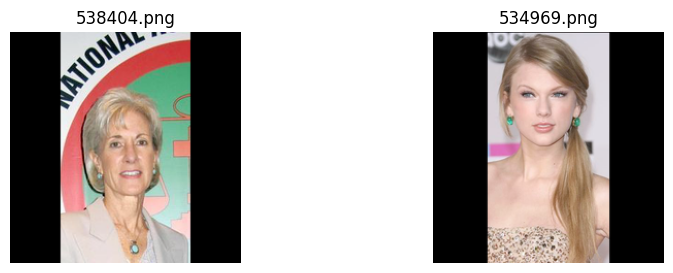

Duplicate found: 537643.png and 532074.png


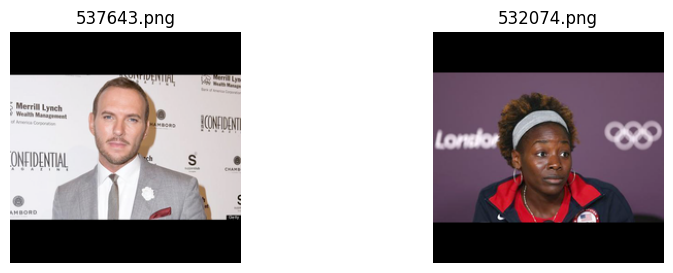

Duplicate found: 544242.png and 544294.png


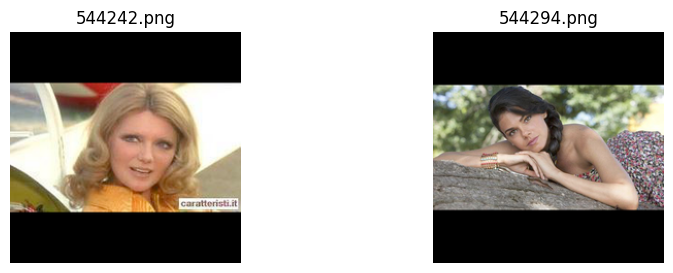

Duplicate found: 537643.png and 508920.png


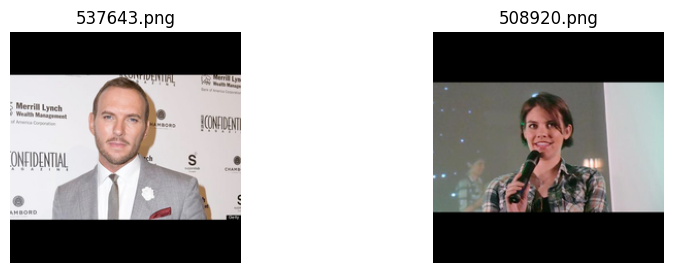

Duplicate found: 537643.png and 513482.png


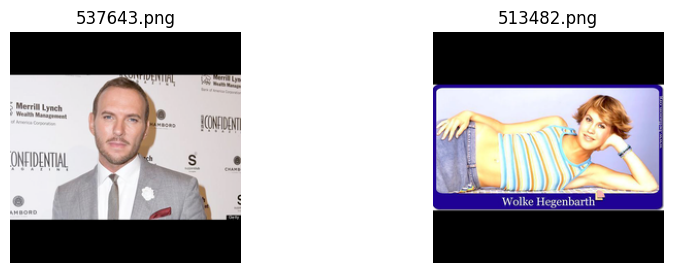

Duplicate found: 556041.png and 498314.png


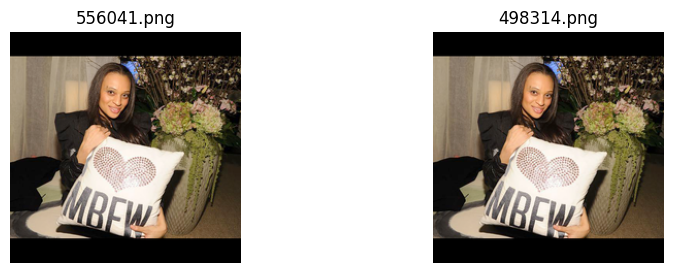

Duplicate found: 499546.png and 521183.png


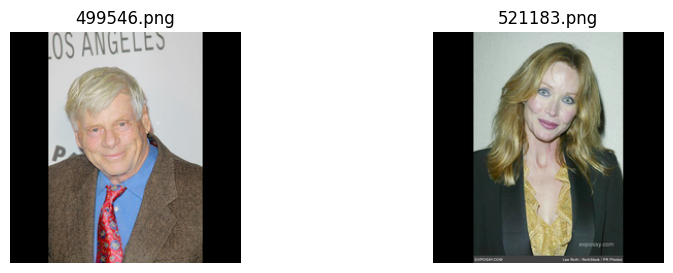

Duplicate found: 538404.png and 550008.png


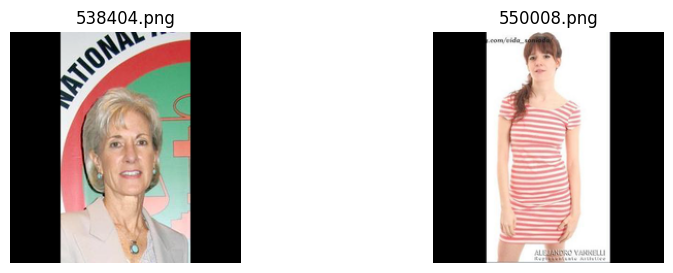

Duplicate found: 528206.png and 535335.png


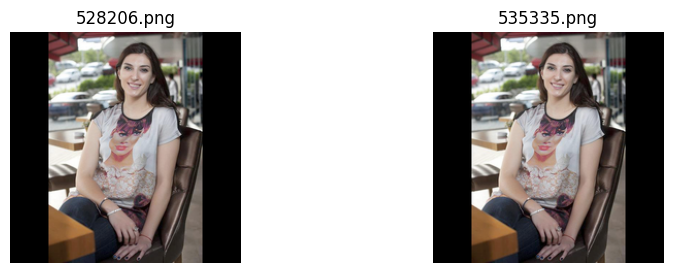

Duplicate found: 538404.png and 527686.png


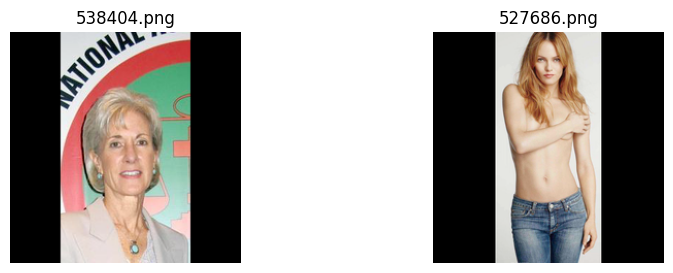

Duplicate found: 538404.png and 558907.png


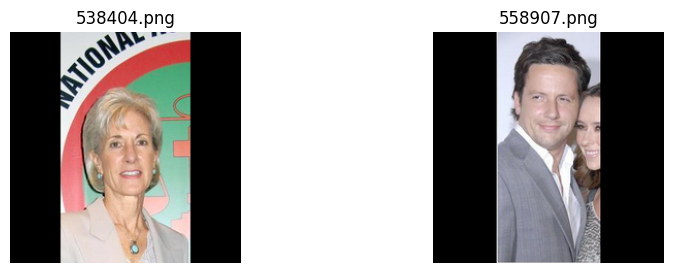

Duplicate found: 537643.png and 496925.png


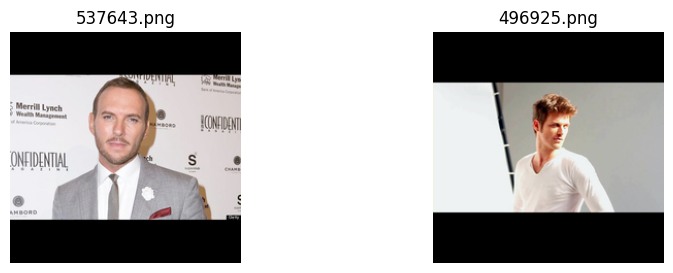

Duplicate found: 534567.png and 529127.png


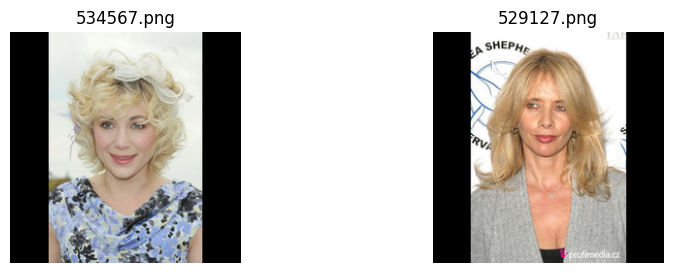

Duplicate found: 541099.png and 550396.png


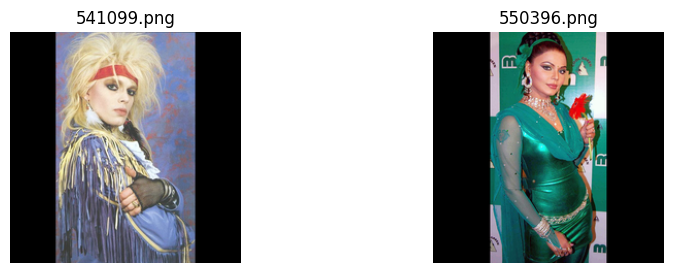

Duplicate found: 506306.png and 531026.png


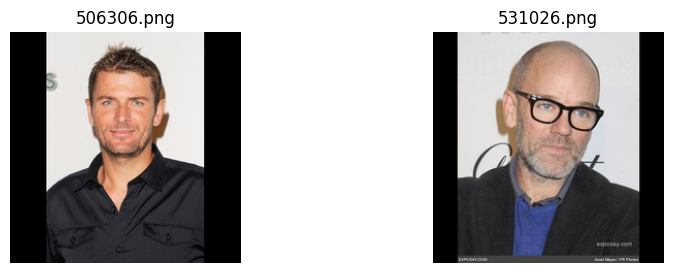

Duplicate found: 543856.png and 535644.png


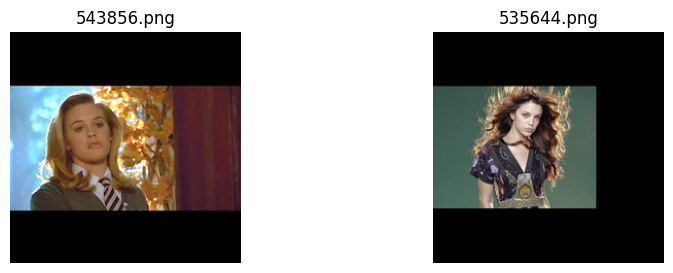

Duplicate found: 506306.png and 540556.png


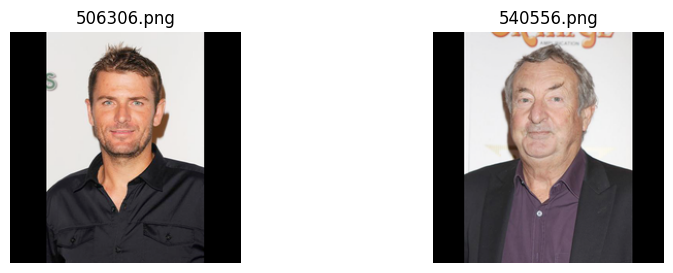

Duplicate found: 537643.png and 498887.png


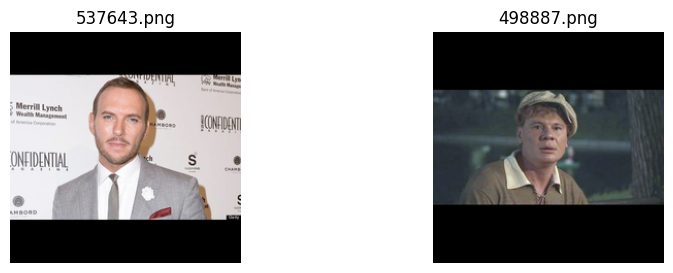

Duplicate found: 547370.png and 557006.png


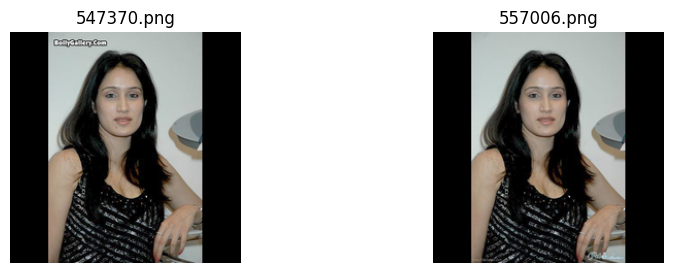

Duplicate found: 496270.png and 515976.png


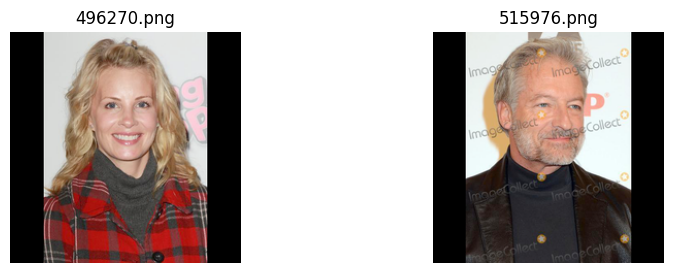

Duplicate found: 527848.png and 506922.png


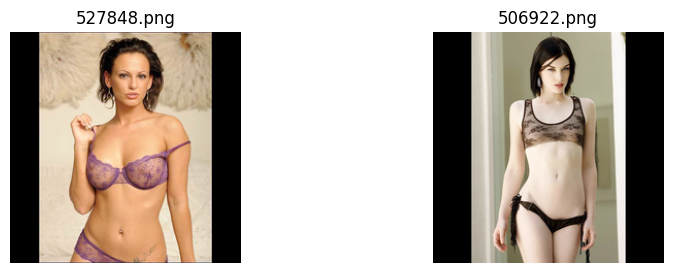

Duplicate found: 542157.png and 521437.png


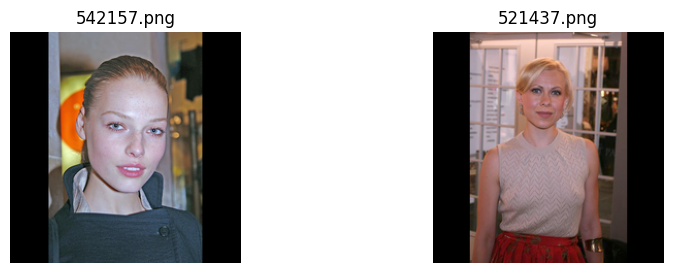

Duplicate found: 537078.png and 546527.png


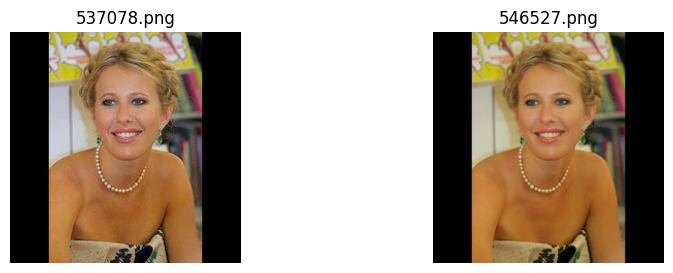

Duplicate found: 524951.png and 500764.png


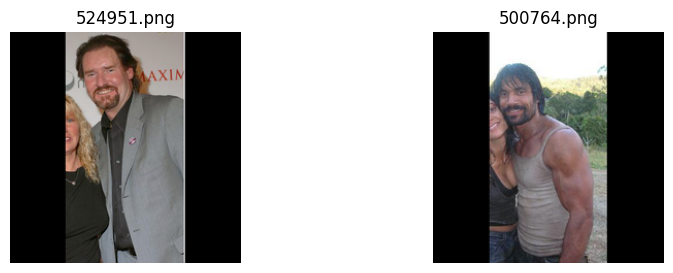

Duplicate found: 538404.png and 516106.png


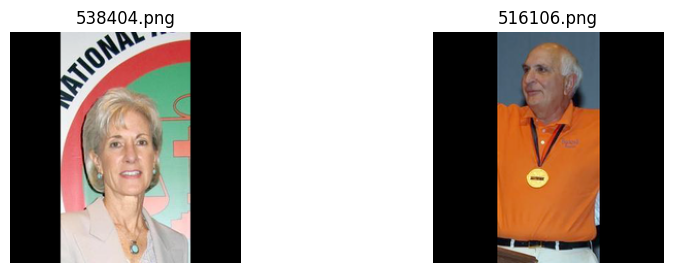

Duplicate found: 537643.png and 516853.png


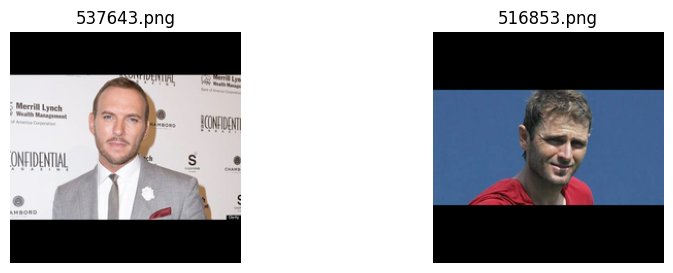

Duplicate found: 561216.png and 559822.png


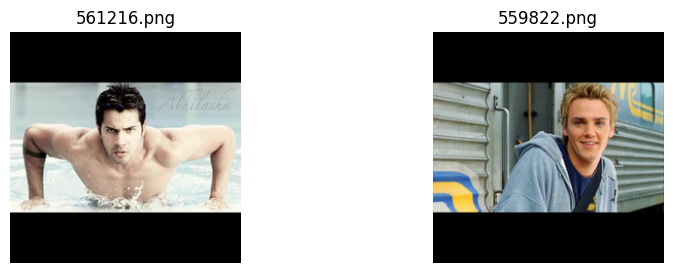

Duplicate found: 537643.png and 503697.png


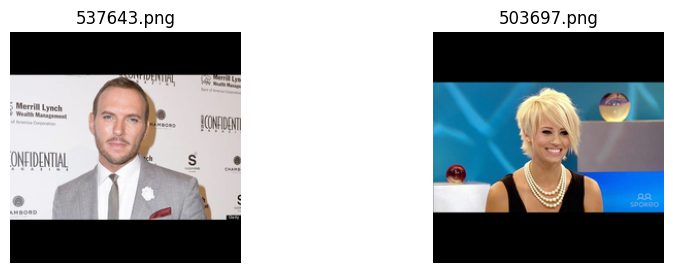

Duplicate found: 537643.png and 508926.png


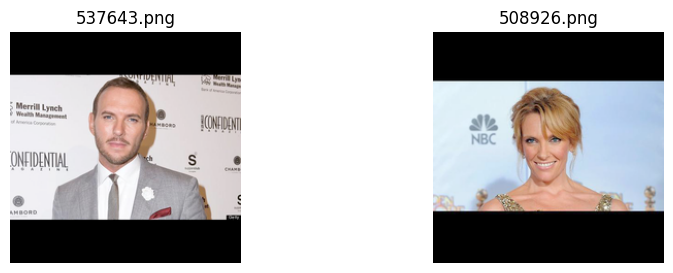

Duplicate found: 533999.png and 558888.png


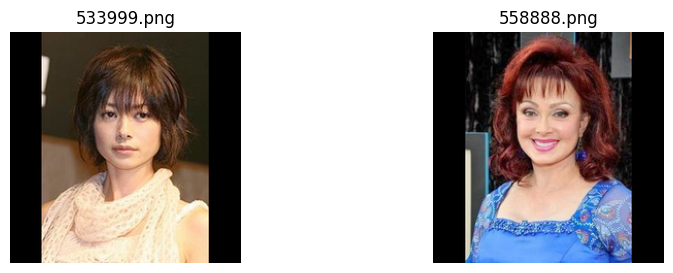

Duplicate found: 539495.png and 548696.png


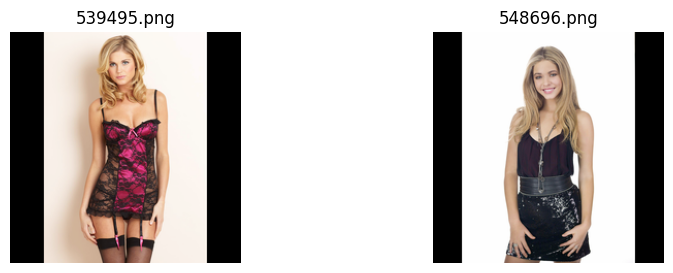

Duplicate found: 537643.png and 508503.png


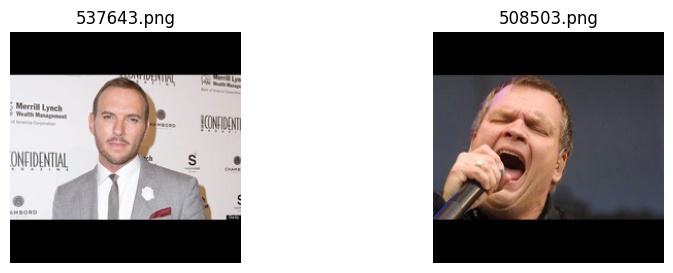

Duplicate found: 526589.png and 519356.png


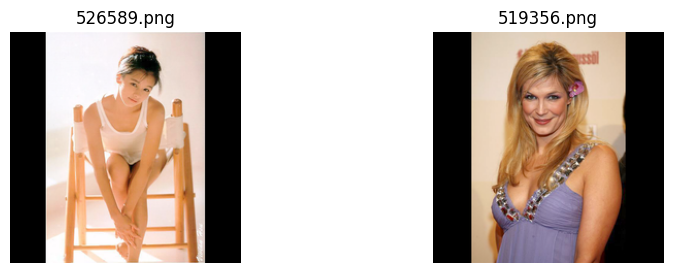

Duplicate found: 537643.png and 537915.png


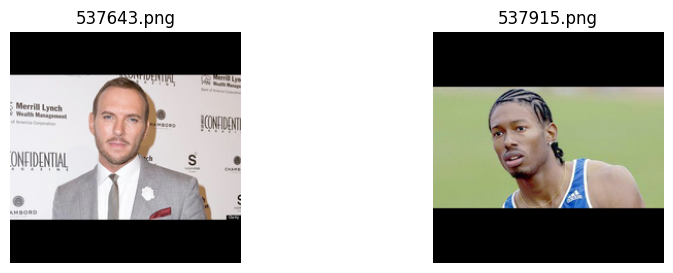

Duplicate found: 538404.png and 522303.png


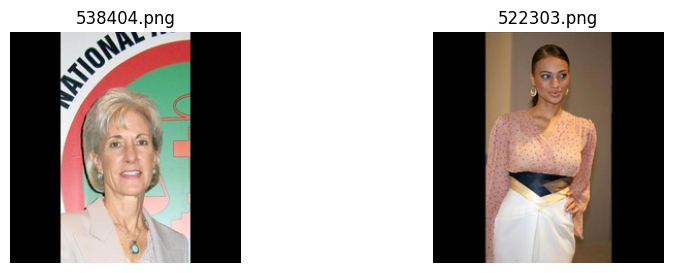

Duplicate found: 553071.png and 523753.png


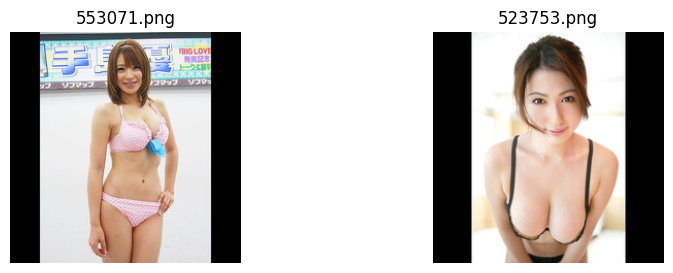

Duplicate found: 539495.png and 539253.png


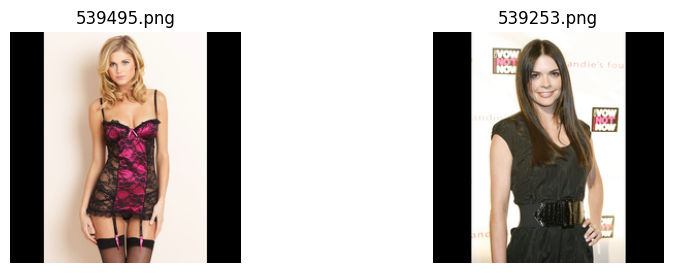

Duplicate found: 537086.png and 522908.png


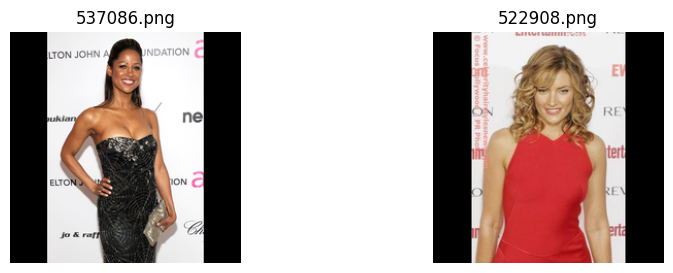

Duplicate found: 538404.png and 529849.png


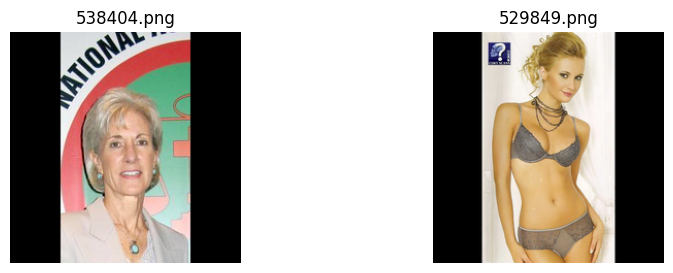

Duplicate found: 539910.png and 541511.png


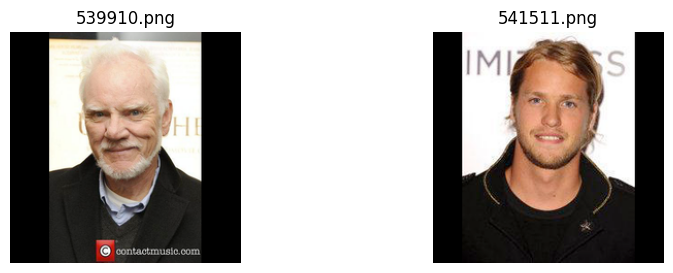

Duplicate found: 538404.png and 506896.png


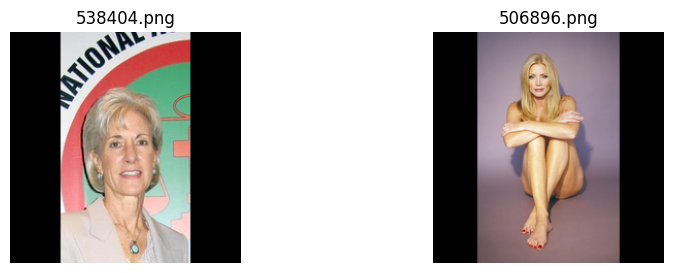

Duplicate found: 538404.png and 552948.png


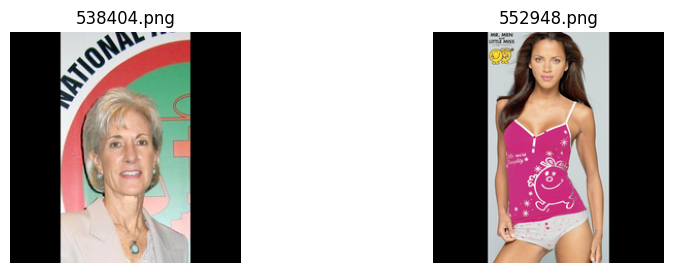

Duplicate found: 537643.png and 558281.png


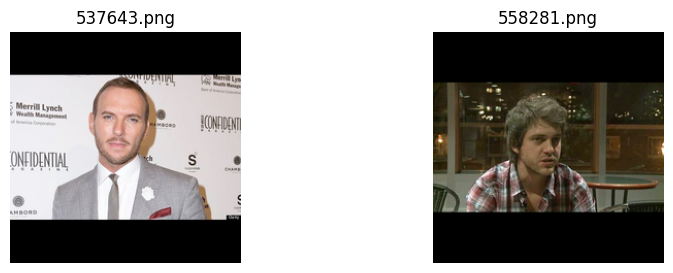

Duplicate found: 538404.png and 552791.png


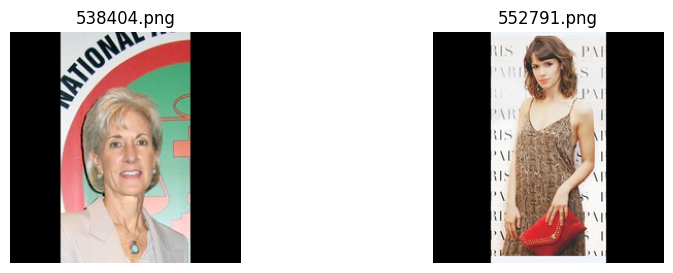

Duplicate found: 537086.png and 503535.png


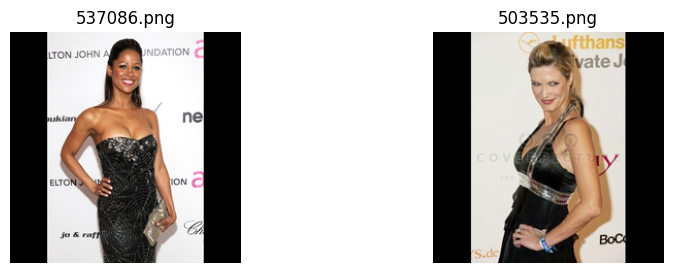

Duplicate found: 554287.png and 499345.png


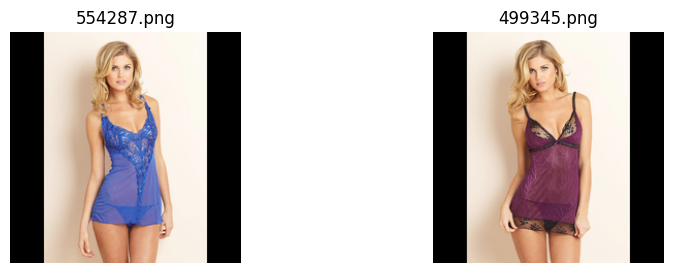

Duplicate found: 537643.png and 552746.png


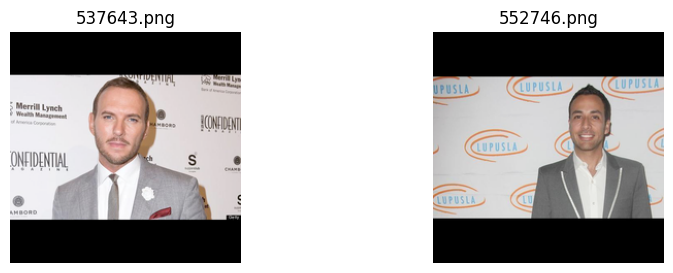

Duplicate found: 532649.png and 520878.png


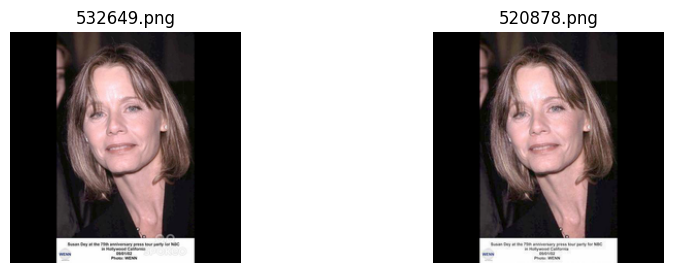

Duplicate found: 515151.png and 548454.png


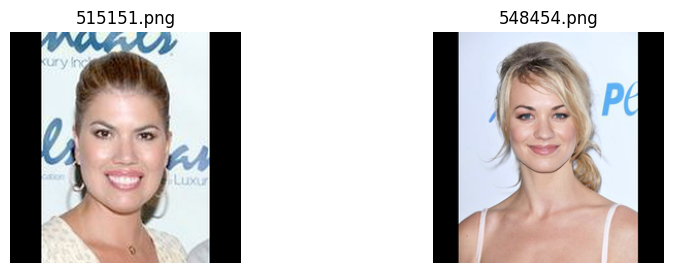

Duplicate found: 537643.png and 509352.png


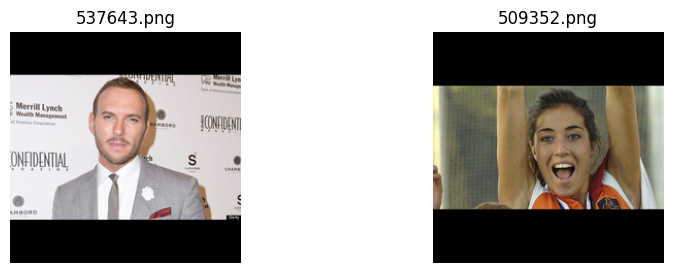

Duplicate found: 537643.png and 495609.png


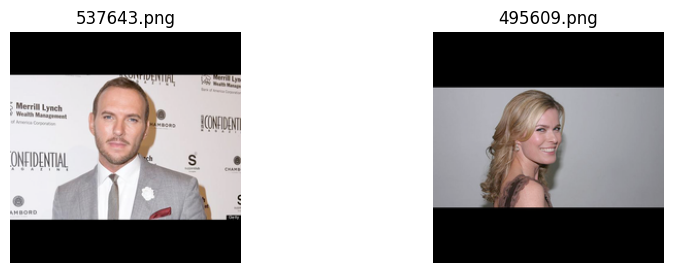

Duplicate found: 537643.png and 498661.png


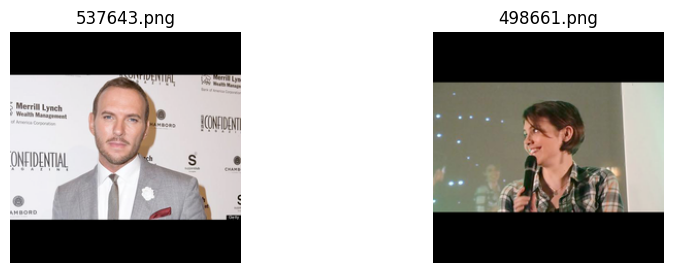

Duplicate found: 529912.png and 555660.png


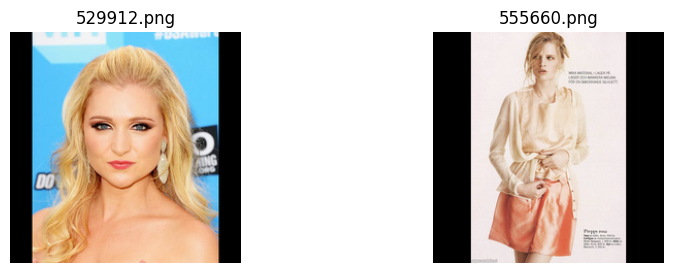

Duplicate found: 541661.png and 540709.png


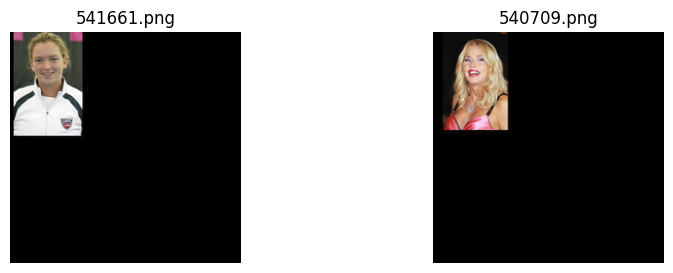

Duplicate found: 538404.png and 504163.png


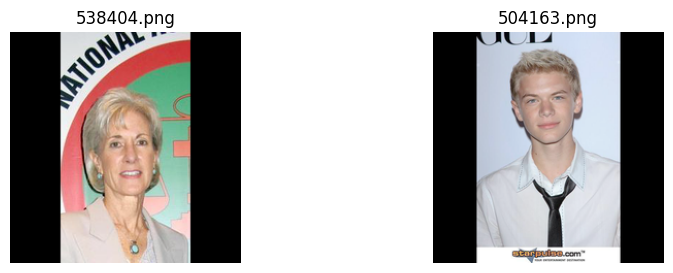

Duplicate found: 527525.png and 535341.png


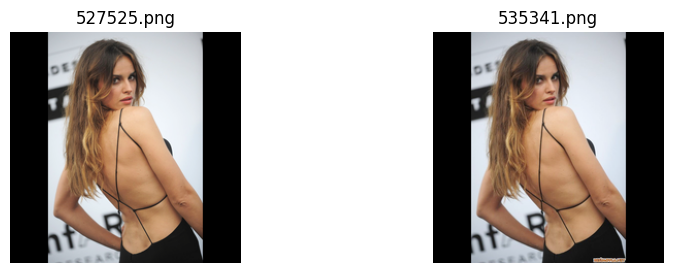

Duplicate found: 541099.png and 558185.png


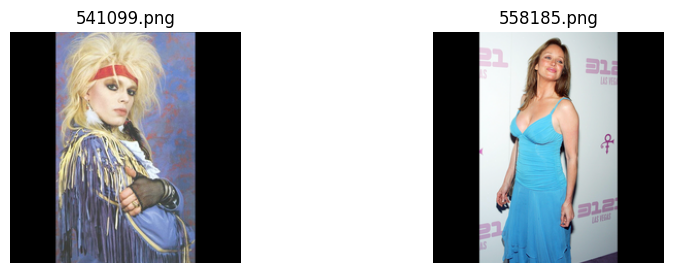

Duplicate found: 552380.png and 533485.png


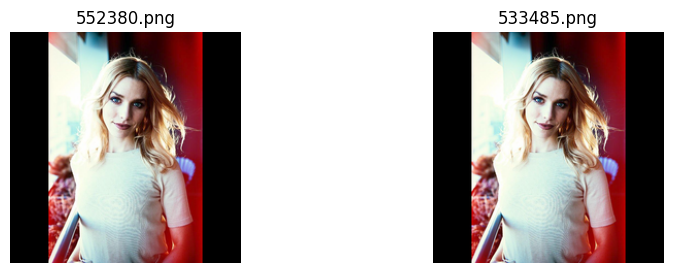

Duplicate found: 538404.png and 509731.png


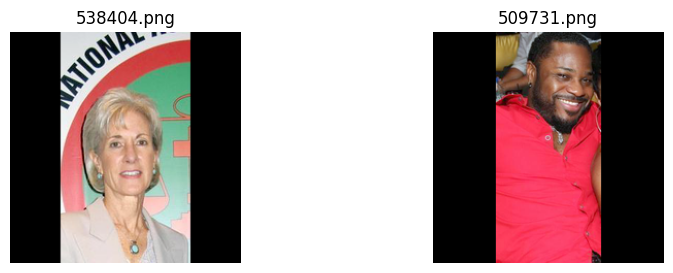

Duplicate found: 536214.png and 520413.png


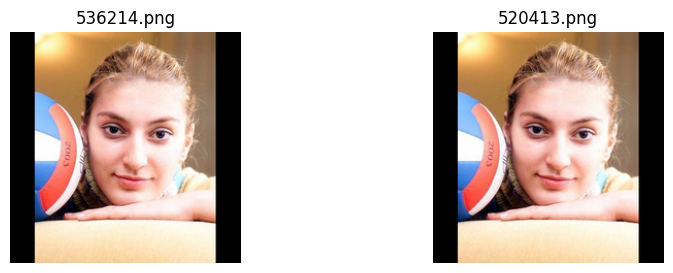

Duplicate found: 524951.png and 513973.png


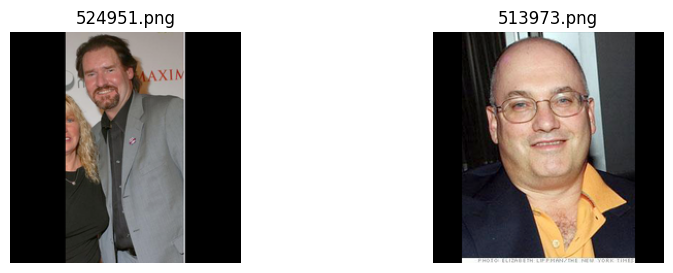

Duplicate found: 536820.png and 535744.png


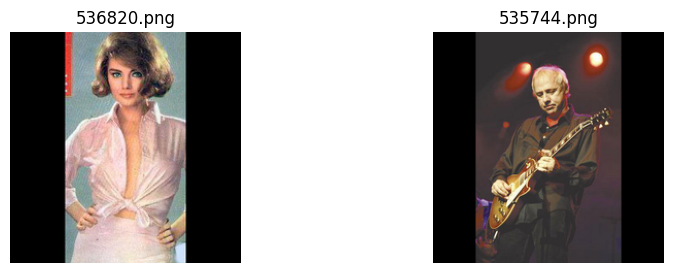

Duplicate found: 538404.png and 521094.png


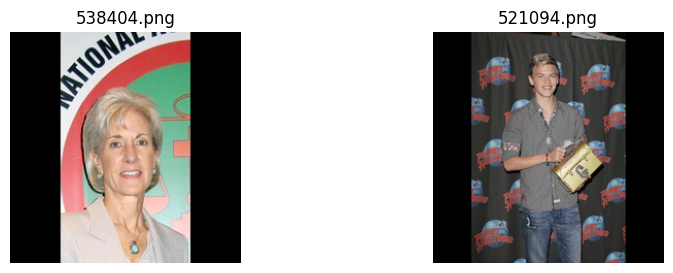

Duplicate found: 543304.png and 543163.png


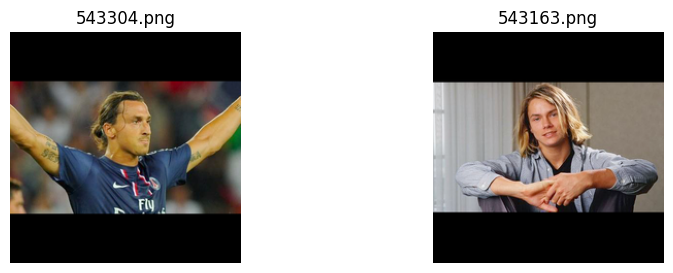

Duplicate found: 561216.png and 526260.png


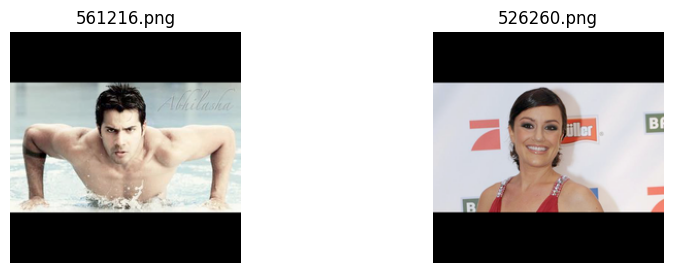

Duplicate found: 537643.png and 536073.png


KeyboardInterrupt: 

In [5]:
# Finding and displaying duplicates in folder1
duplicates_folder1 = find_duplicates_in_folder(folder1)
print("Duplicates in Folder 1:")
print(f"Number of duplicate pairs: {len(duplicates_folder1)}")
for dup in duplicates_folder1:
    print(f"Duplicate found: {os.path.basename(dup[0])} and {os.path.basename(dup[1])}")
    display_images(dup)

# Finding and displaying duplicates in folder2
duplicates_folder2 = find_duplicates_in_folder(folder2)
print("\nDuplicates in Folder 2:")
print(f"Number of duplicate pairs: {len(duplicates_folder2)}")
for dup in duplicates_folder2:
    print(f"Duplicate found: {os.path.basename(dup[0])} and {os.path.basename(dup[1])}")
    display_images(dup)

Observing the displayed images identified as "duplicates", despite having many actual duplicates, <mark>there are also many false positives</mark>, which do share some similarities, such as the postures of figures, skin and/or hair colors, etc.
<br>I will try a more robust hashing technique to address this, <mark>using the phash method from imagehash</mark>, which is generally more robust than average hashing.

## Perceptual Hashing (pHash)

In [6]:
from PIL import Image
import imagehash

def get_image_phash(image_path):
    # Open an image file
    with Image.open(image_path) as img:
        # Use perceptual hashing to calculate the image hash
        hash = imagehash.phash(img)
    
    # Return the hash as a string
    return str(hash)


def find_duplicates_in_folder_phash(folder):
    hash_dict = {}
    duplicates = []
    for filename in os.listdir(folder):
        file_path = os.path.join(folder, filename)
        image_hash = get_image_phash(file_path)
        if image_hash in hash_dict:
            duplicates.append((hash_dict[image_hash], file_path))  # Storing full paths
        else:
            hash_dict[image_hash] = file_path
    return duplicates

### Duplicates for Live

Duplicates in Folder 1:
Number of duplicate pairs: 79
Duplicate found: 556041.png and 498314.png


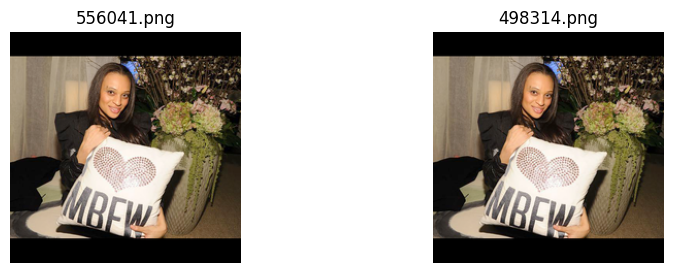

Duplicate found: 528206.png and 535335.png


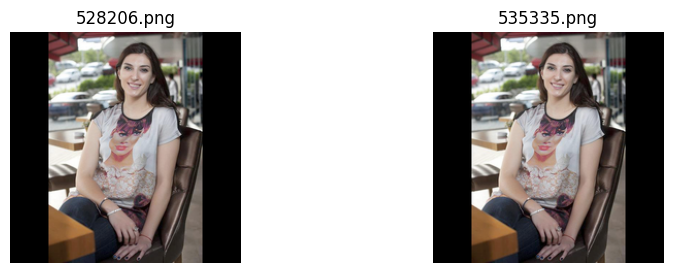

Duplicate found: 537078.png and 546527.png


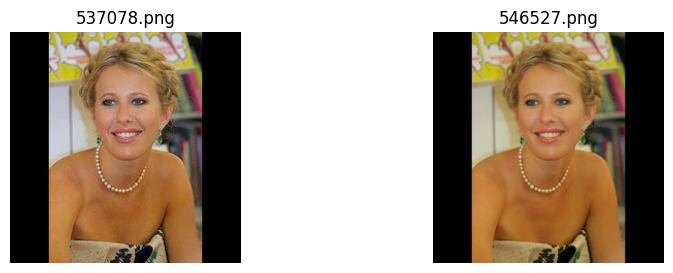

Duplicate found: 547629.png and 526951.png


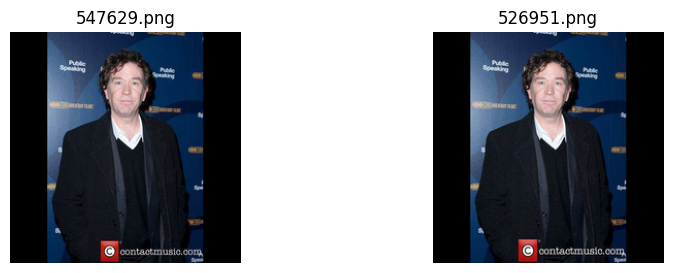

Duplicate found: 532649.png and 520878.png


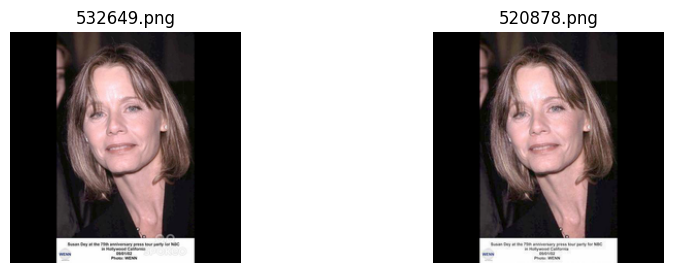

Duplicate found: 552380.png and 533485.png


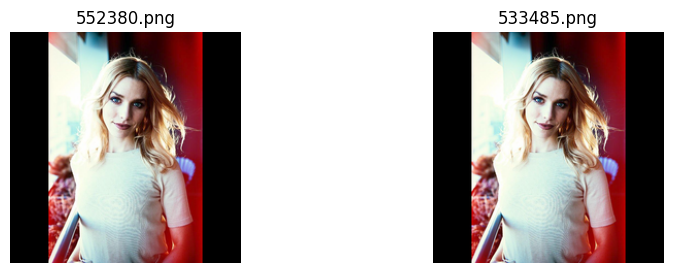

Duplicate found: 536214.png and 520413.png


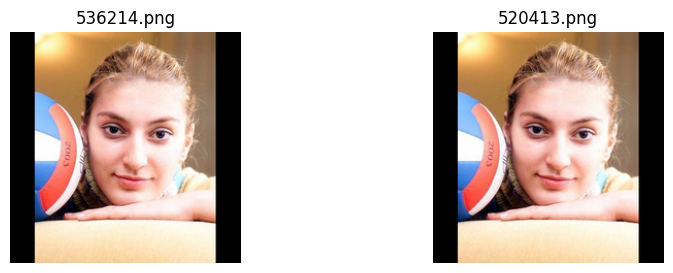

Duplicate found: 547993.png and 500879.png


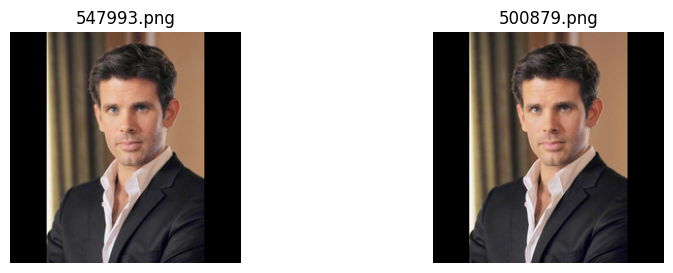

Duplicate found: 552036.png and 504564.png


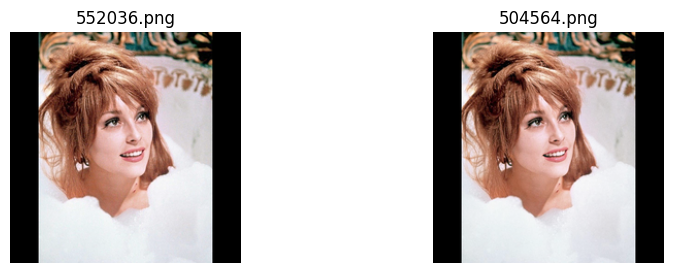

Duplicate found: 535292.png and 515468.png


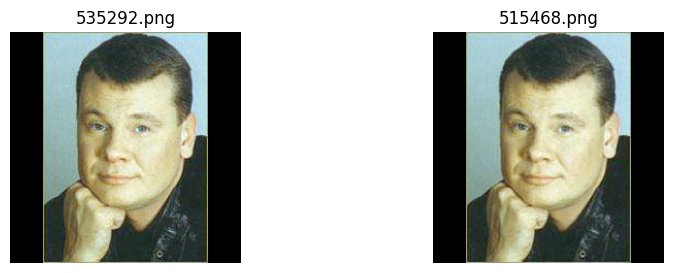

Duplicate found: 509154.png and 536049.png


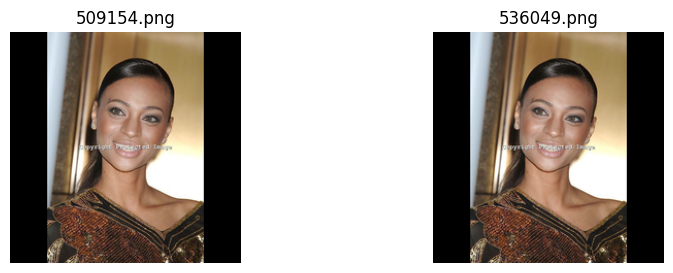

Duplicate found: 553702.png and 557460.png


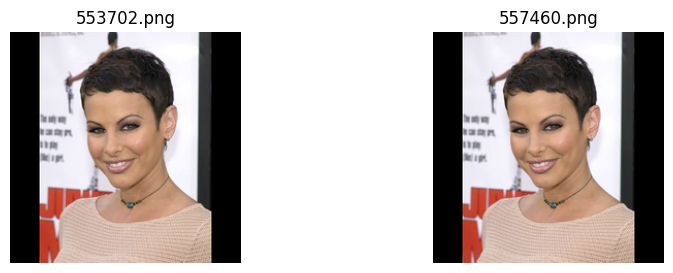

Duplicate found: 552556.png and 549676.png


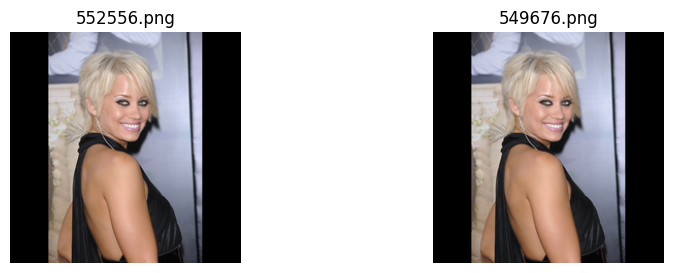

Duplicate found: 538611.png and 517078.png


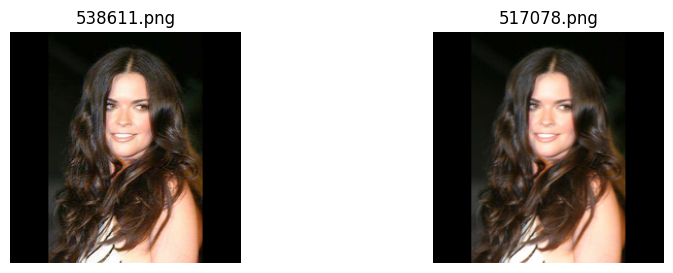

Duplicate found: 501018.png and 527781.png


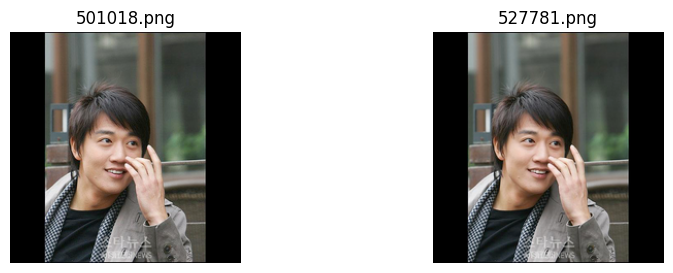

Duplicate found: 504954.png and 537209.png


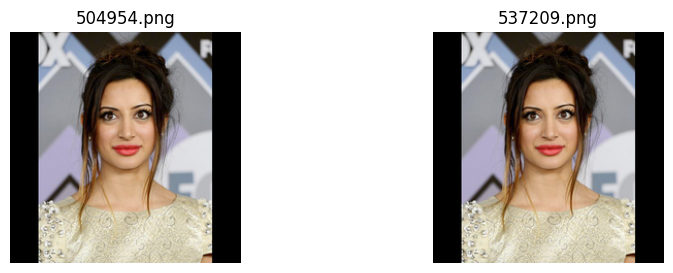

Duplicate found: 494896.png and 541002.png


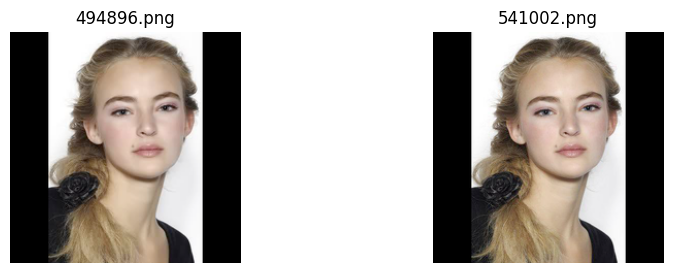

Duplicate found: 503542.png and 516205.png


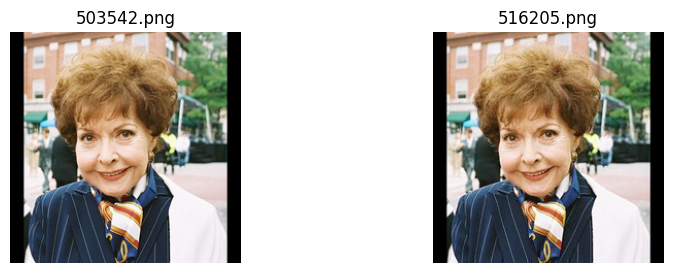

Duplicate found: 520329.png and 540269.png


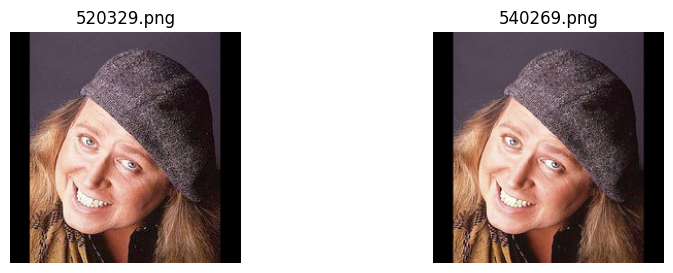

Duplicate found: 540618.png and 497879.png


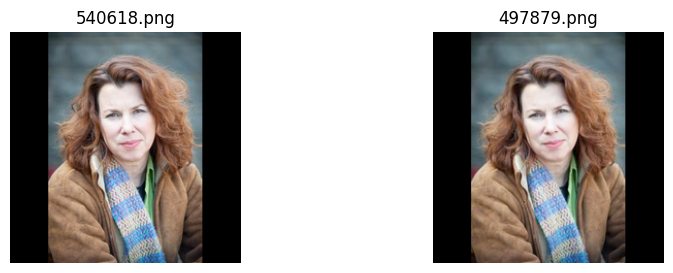

Duplicate found: 545788.png and 498034.png


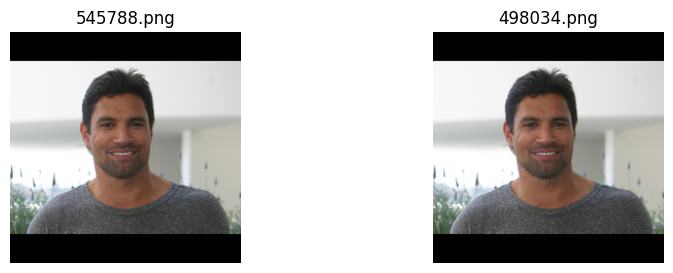

Duplicate found: 555947.png and 552339.png


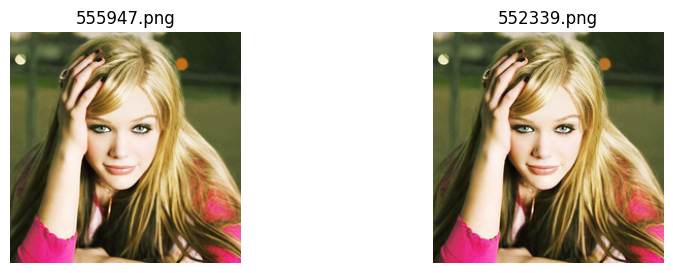

Duplicate found: 541850.png and 551746.png


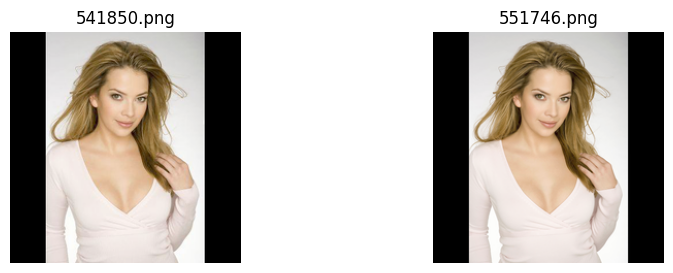

Duplicate found: 501024.png and 526929.png


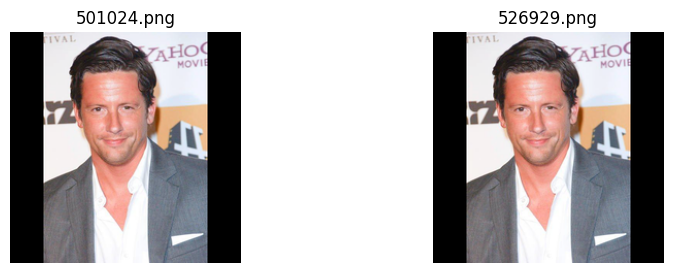

Duplicate found: 499353.png and 532145.png


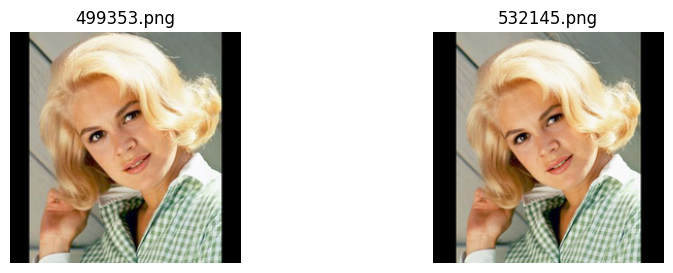

Duplicate found: 496351.png and 535616.png


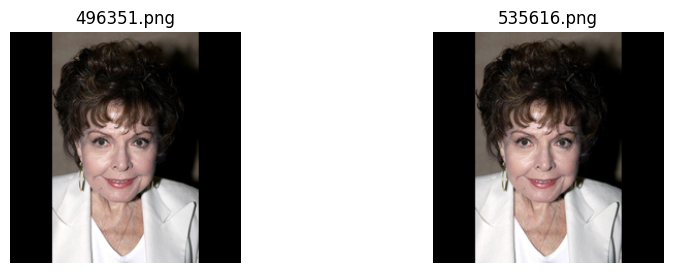

Duplicate found: 553568.png and 559848.png


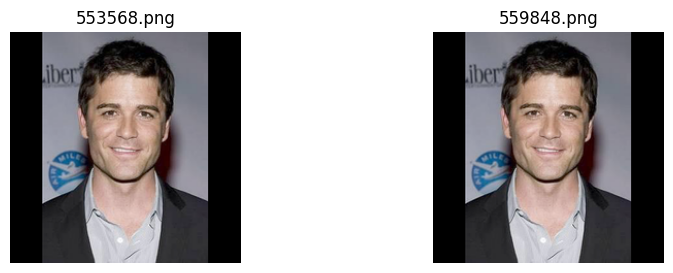

Duplicate found: 498215.png and 498187.png


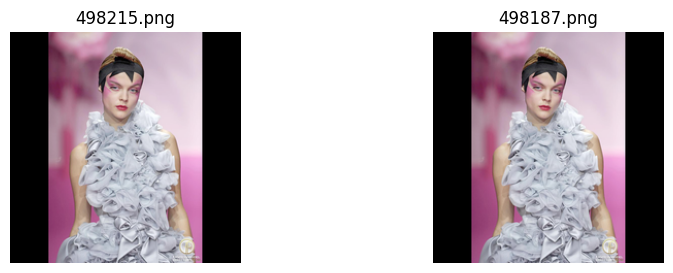

Duplicate found: 522562.png and 534735.png


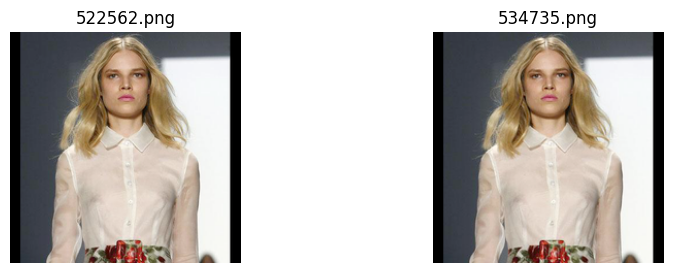

Duplicate found: 546093.png and 559678.png


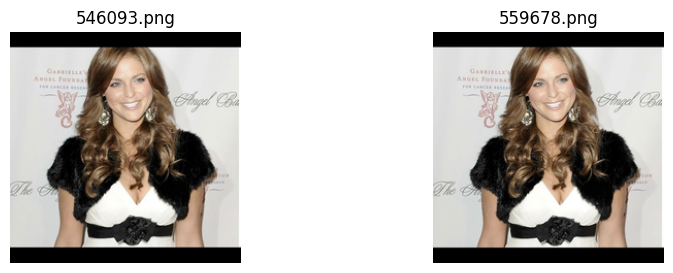

Duplicate found: 544898.png and 557866.png


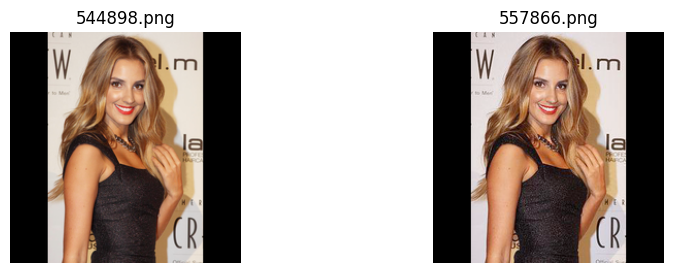

Duplicate found: 514414.png and 514745.png
Duplicate found: 500240.png and 546567.png
Duplicate found: 525634.png and 505258.png
Duplicate found: 550078.png and 560615.png
Duplicate found: 514717.png and 503114.png
Duplicate found: 556198.png and 512958.png
Duplicate found: 523512.png and 539459.png
Duplicate found: 533869.png and 508323.png
Duplicate found: 548391.png and 535706.png
Duplicate found: 535916.png and 513306.png
Duplicate found: 499643.png and 518904.png
Duplicate found: 508576.png and 523986.png
Duplicate found: 556968.png and 548869.png
Duplicate found: 542691.png and 532651.png
Duplicate found: 538472.png and 500185.png
Duplicate found: 558415.png and 547755.png
Duplicate found: 517312.png and 559594.png
Duplicate found: 546195.png and 536972.png
Duplicate found: 506231.png and 552210.png
Duplicate found: 551968.png and 497366.png
Duplicate found: 514284.png and 521017.png
Duplicate found: 530769.png and 516137.png
Duplicate found: 539555.png and 515228.png
Duplicate f

In [9]:
# Finding and displaying duplicates in folder1
duplicates_folder1 = find_duplicates_in_folder_phash(folder1)
print("Duplicates in Folder 1:")
print(f"Number of duplicate pairs: {len(duplicates_folder1)}")
count = 0
for dup in duplicates_folder1:
    print(f"Duplicate found: {os.path.basename(dup[0])} and {os.path.basename(dup[1])}")
    if count <= 30:
        display_images(dup)
        count += 1

### Duplicates for Spoof


Duplicates in Folder 2:
Number of duplicate pairs: 12989
Duplicate found: 548646.png and 524944.png


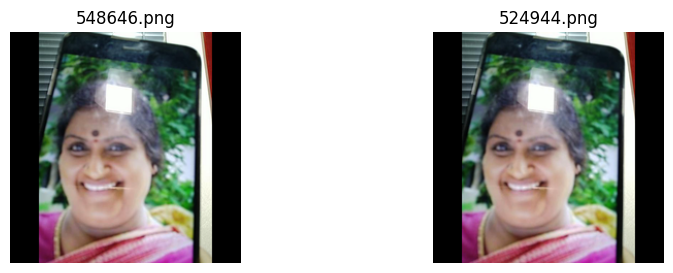

Duplicate found: 533586.png and 539083.png


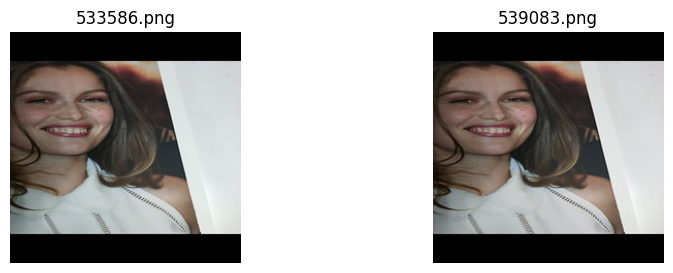

Duplicate found: 511041.png and 501285.png


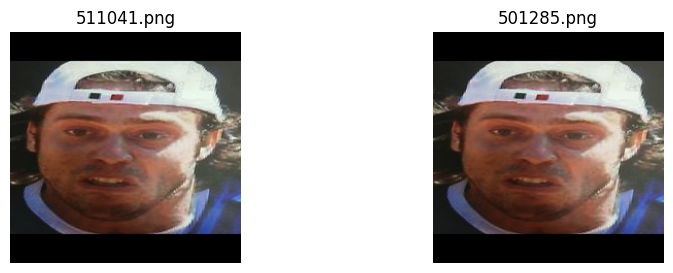

Duplicate found: 554521.png and 536429.png


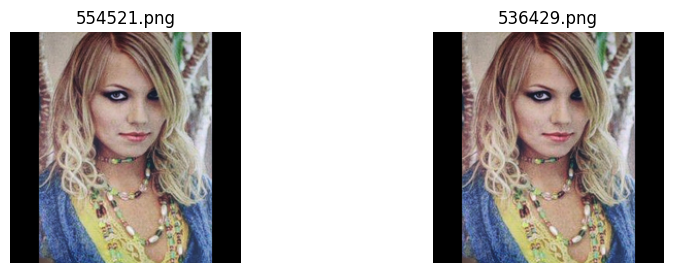

Duplicate found: 548646.png and 537723.png


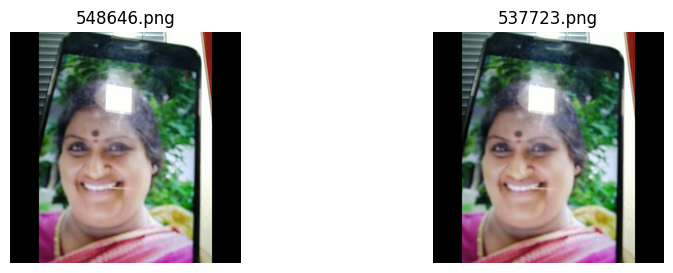

Duplicate found: 553266.png and 519384.png


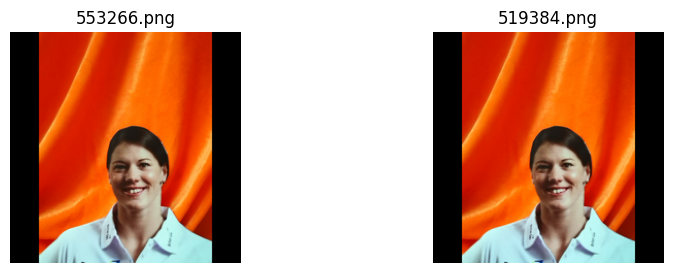

Duplicate found: 528818.png and 495143.png


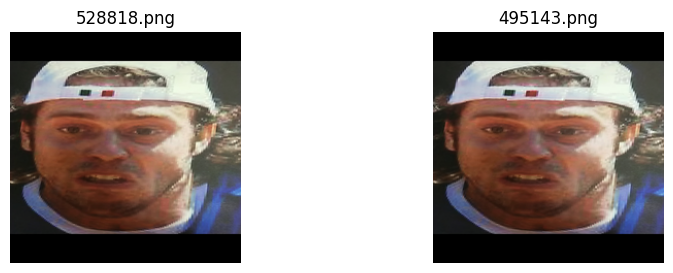

Duplicate found: 552144.png and 550579.png


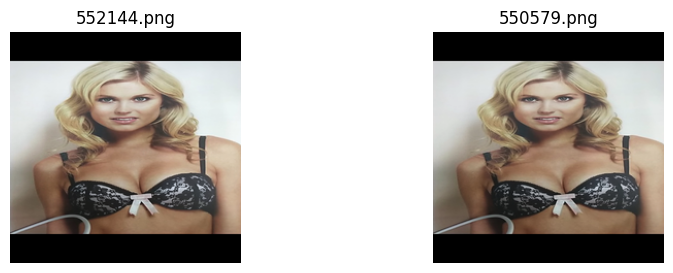

Duplicate found: 556493.png and 514475.png


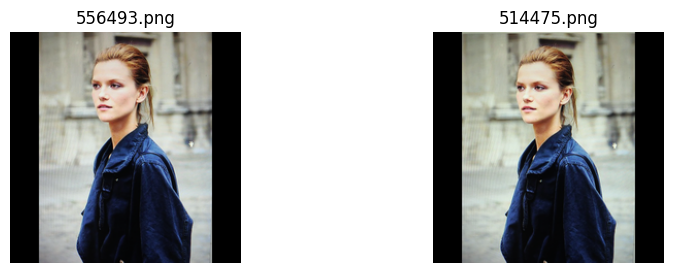

Duplicate found: 512206.png and 496476.png


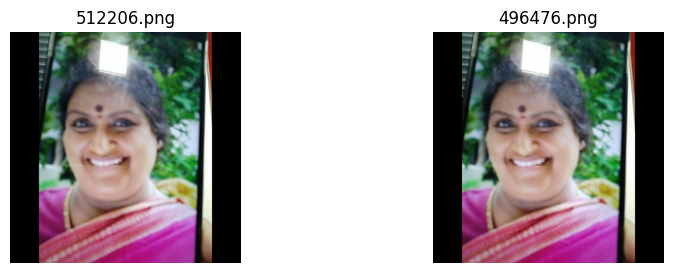

Duplicate found: 524987.png and 509424.png


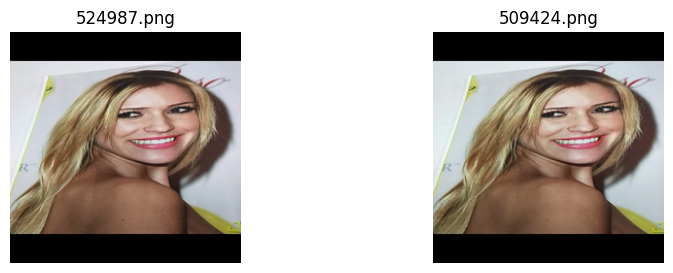

Duplicate found: 516048.png and 500372.png


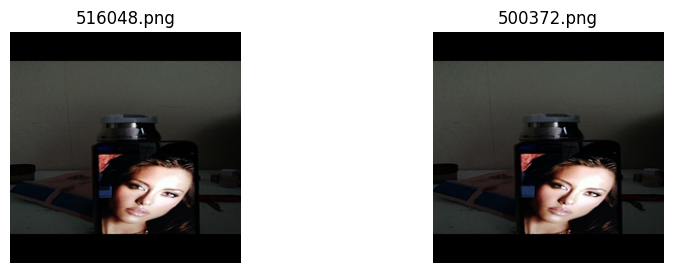

Duplicate found: 529509.png and 513483.png


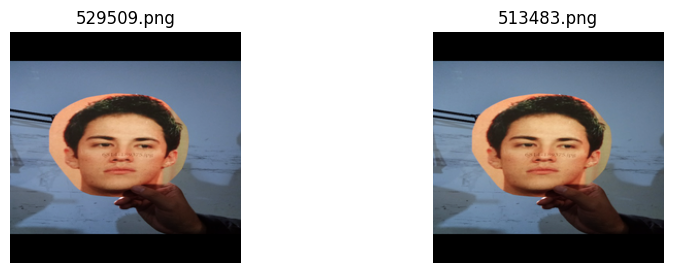

Duplicate found: 517140.png and 535336.png


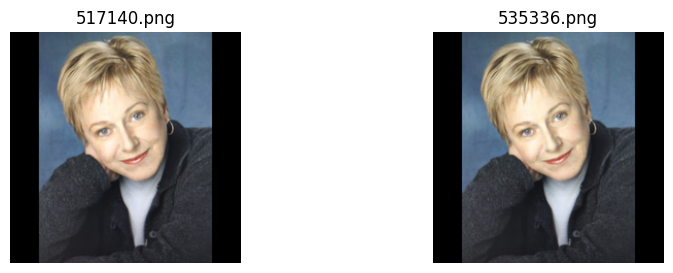

Duplicate found: 540018.png and 523554.png


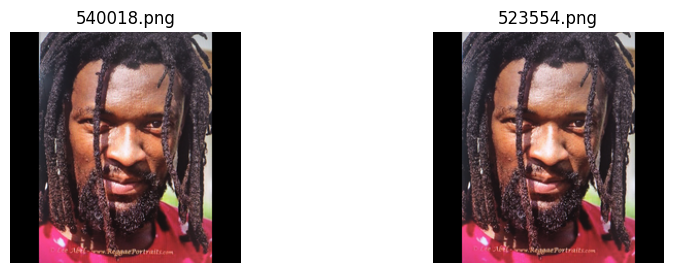

Duplicate found: 494705.png and 538174.png


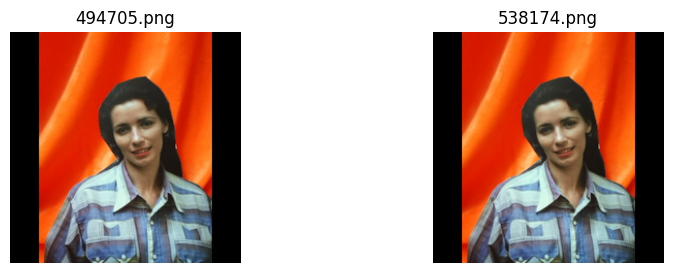

Duplicate found: 519435.png and 515780.png


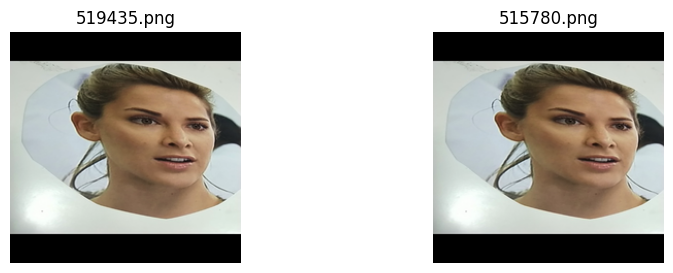

Duplicate found: 504128.png and 550586.png


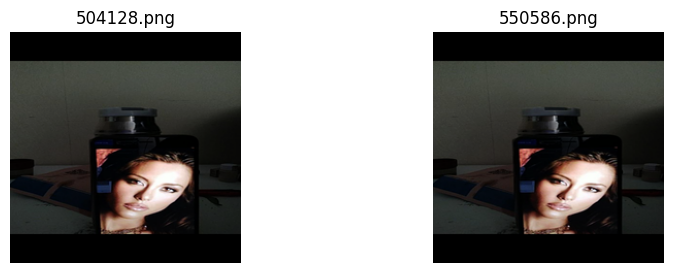

Duplicate found: 504699.png and 515623.png


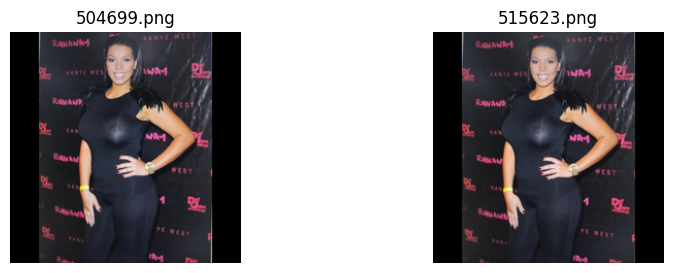

Duplicate found: 561029.png and 553676.png


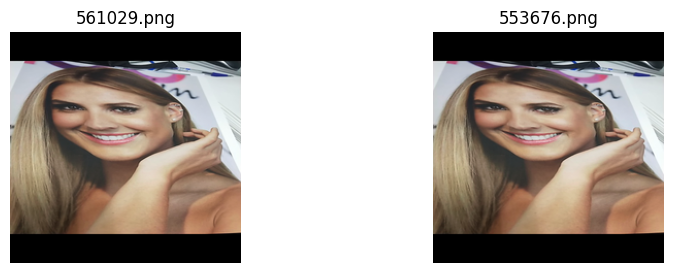

Duplicate found: 531391.png and 543303.png


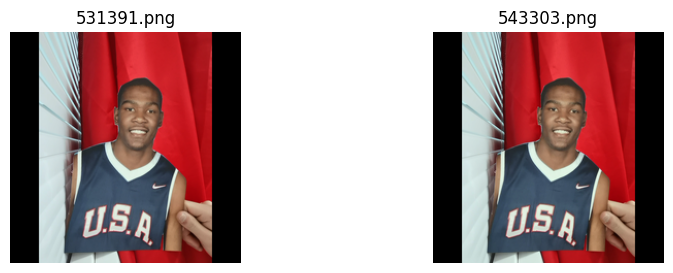

Duplicate found: 545174.png and 503055.png


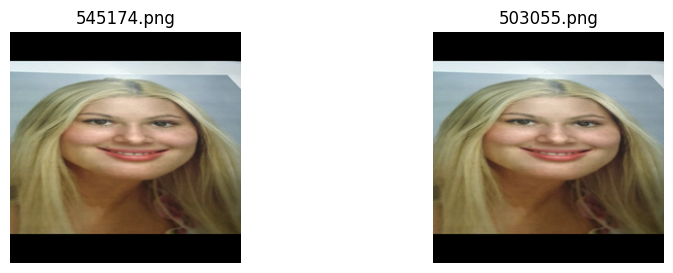

Duplicate found: 545160.png and 541266.png


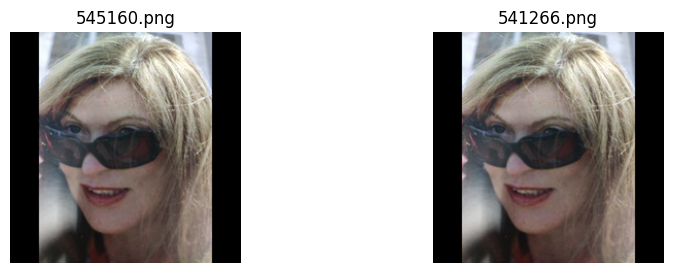

Duplicate found: 540018.png and 536978.png


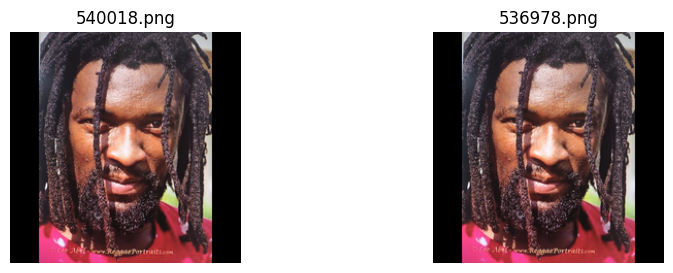

Duplicate found: 557982.png and 516470.png


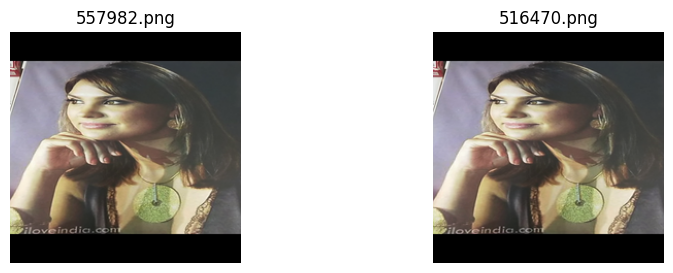

Duplicate found: 499779.png and 529694.png


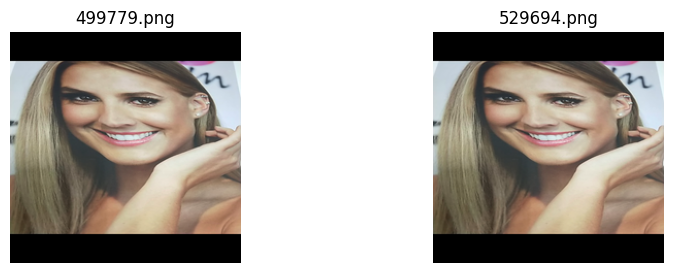

Duplicate found: 527281.png and 519031.png


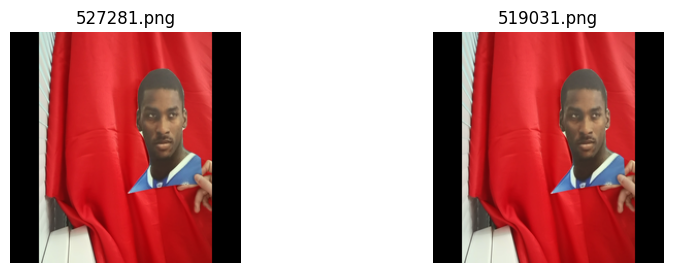

Duplicate found: 538606.png and 520868.png


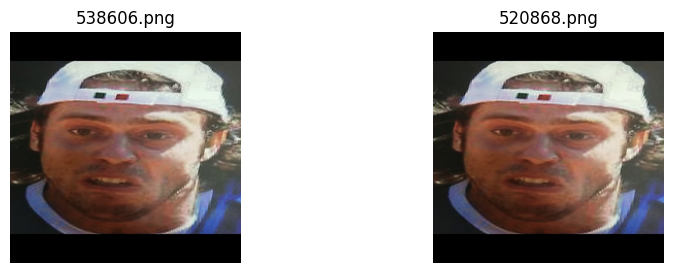

Duplicate found: 523232.png and 544322.png


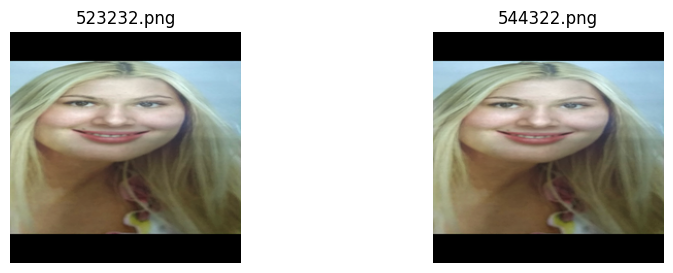

Duplicate found: 543317.png and 536039.png


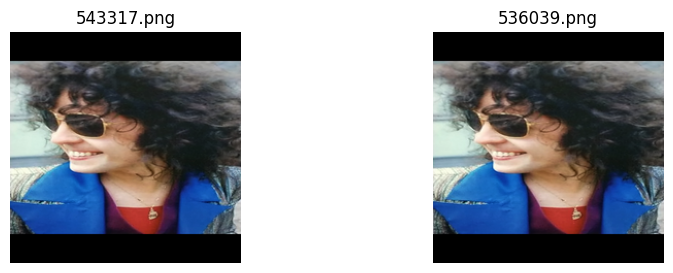

Duplicate found: 557982.png and 531756.png


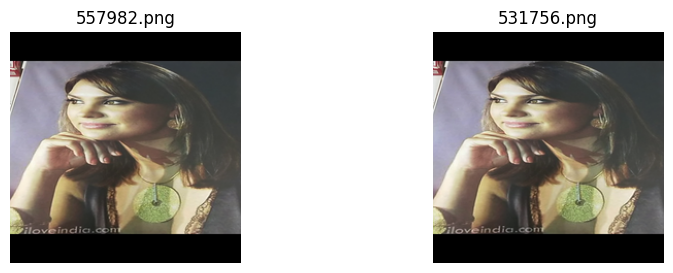

Duplicate found: 527732.png and 512825.png
Duplicate found: 539726.png and 523420.png
Duplicate found: 542974.png and 520667.png
Duplicate found: 539068.png and 542790.png
Duplicate found: 522845.png and 534389.png
Duplicate found: 527849.png and 551277.png
Duplicate found: 517424.png and 521948.png
Duplicate found: 510175.png and 494881.png
Duplicate found: 516458.png and 498063.png
Duplicate found: 506111.png and 541702.png
Duplicate found: 561203.png and 504276.png
Duplicate found: 494705.png and 519227.png
Duplicate found: 553879.png and 504510.png
Duplicate found: 561149.png and 515409.png
Duplicate found: 519435.png and 504504.png
Duplicate found: 503069.png and 543897.png
Duplicate found: 504128.png and 521974.png
Duplicate found: 505791.png and 530879.png
Duplicate found: 506059.png and 502613.png
Duplicate found: 545564.png and 533425.png
Duplicate found: 538606.png and 521747.png
Duplicate found: 537910.png and 503294.png
Duplicate found: 556256.png and 561377.png
Duplicate f

In [11]:
# Finding and displaying duplicates in folder2
duplicates_folder2 = find_duplicates_in_folder_phash(folder2)
print("\nDuplicates in Folder 2:")
print(f"Number of duplicate pairs: {len(duplicates_folder2)}")
count = 0
for dup in duplicates_folder2:
    print(f"Duplicate found: {os.path.basename(dup[0])} and {os.path.basename(dup[1])}")
    if count <= 30:
        display_images(dup)
        count += 1

## Difference Hashing (dHash) => ended up not using because pHashing worked
Difference hashing computes the gradient direction in an image, making it excellent at detecting duplicates that have undergone minor alterations such as compression artifacts or changes in aspect ratio.

In [ ]:
from PIL import Image
import imagehash

def get_image_dhash(image_path):
    with Image.open(image_path) as img:
        # Use difference hashing
        hash = imagehash.dhash(img)
    return str(hash)

def find_duplicates_in_folder_dhash(folder):
    hash_dict = {}
    duplicates = []
    for filename in os.listdir(folder):
        file_path = os.path.join(folder, filename)
        image_hash = get_image_dhash(file_path)
        if image_hash in hash_dict:
            duplicates.append((hash_dict[image_hash], file_path))  # Storing full paths
        else:
            hash_dict[image_hash] = file_path
    return duplicates

In [ ]:
# Finding and displaying duplicates in folder1
duplicates_folder1 = find_duplicates_in_folder_dhash(folder1)
print("Duplicates in Folder 1:")
print(f"Number of duplicate pairs: {len(duplicates_folder1)}")
for dup in duplicates_folder1:
    print(f"Duplicate found: {os.path.basename(dup[0])} and {os.path.basename(dup[1])}")
    display_images(dup)

# Finding and displaying duplicates in folder2
duplicates_folder2 = find_duplicates_in_folder_dhash(folder2)
print("\nDuplicates in Folder 2:")
print(f"Number of duplicate pairs: {len(duplicates_folder2)}")
for dup in duplicates_folder2:
    print(f"Duplicate found: {os.path.basename(dup[0])} and {os.path.basename(dup[1])}")
    display_images(dup)